## Getting Started with Images

This notebook will help you take your first steps in learning Image Processing and Computer Vision using OpenCV. You will learn some important lessons using some simple examples. In this notebook, you will learn the following:

* Reading an image
* Check image attributes like datatype and shape
* Matrix representation of an image in Numpy
* Color Images and splitting/merging image channels
* Displaying images using matplotlib
* Saving images

## Import Libraries

In [5]:
import os
import cv2
import numpy as np
import matplotlib.pyplot as plt

from zipfile import ZipFile
from urllib.request import urlretrieve

from IPython.display import Image

%matplotlib inline

## Download Assets

The `download_and_unzip(...)` is used to download and extract the notebook assests.

In [3]:
def download_and_unzip(url, save_path):
    print(f"Downloading and extracting assests....", end="")

    # Downloading zip file using urllib package.
    urlretrieve(url, save_path)

    try:
        # Extracting zip file using the zipfile package.
        with ZipFile(save_path) as z:
            # Extract ZIP file contents in the same directory.
            z.extractall(os.path.split(save_path)[0])

        print("Done")

    except Exception as e:
        print("\nInvalid file.", e)

In [5]:
URL = r"https://www.dropbox.com/s/qhhlqcica1nvtaw/opencv_bootcamp_assets_NB1.zip?dl=1"

asset_zip_path = os.path.join(os.getcwd(), "opencv_bootcamp_assets_NB1.zip")

# Download if assest ZIP does not exists.
if not os.path.exists(asset_zip_path):
    download_and_unzip(URL, asset_zip_path)

The opencv_bootcamp_assets_NB1.zip` file includes also contains the additional **display_image.py** python script.

## Display Image Directly
We will use the following as our sample images. We will use the ipython image function to load and display the image. It can display images from local or online.

```python
from IPython.Display import Image
```

In [19]:
# Display 18x18 pixel image. This is possible because we called the function from the IPython.Display
Image(filename="./images/checkerboard_18x18.png")

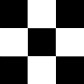

In [20]:
# Display 84x84 pixel image.
Image(filename="./images/checkerboard_84x84.jpg")

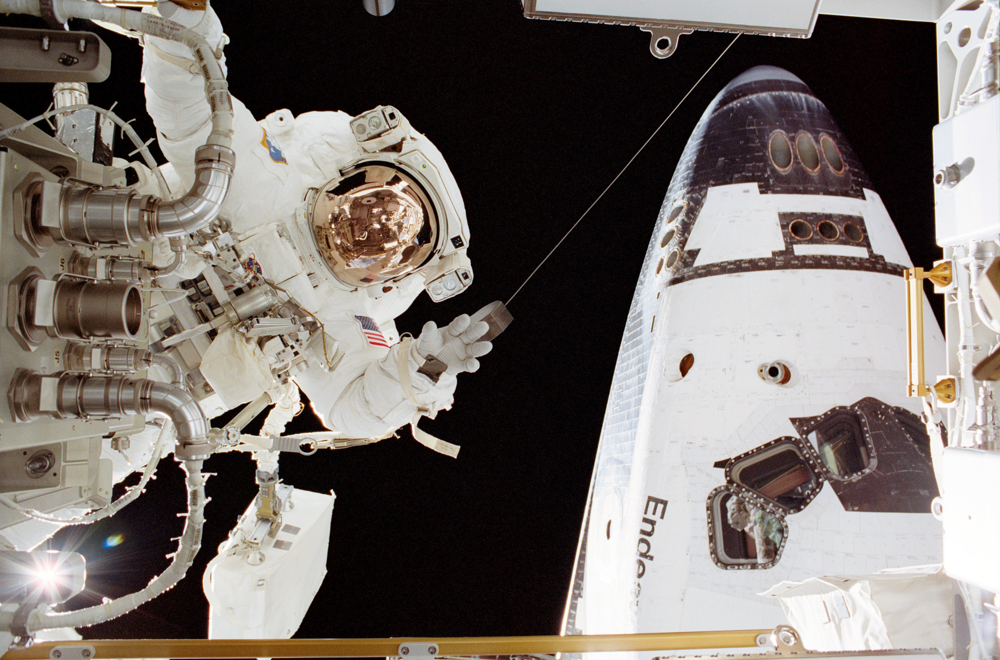

In [21]:
Image(
    "https://www.nasa.gov/wp-content/uploads/2024/11/0302398orig.jpg",
    height=400,
    width=400,
)

## Reading images using OpenCV

OpenCV allows reading different types of images (JPG, PNG, etc). You can load grayscale images, color images or you can also load images with Alpha channel. It uses the **`cv2.imread()`** function which has the following syntax:

### <font color="green">Function Syntax </font>

``` python
retval = cv2.imread( filename[, flags] )
```

`retval`: Is the image if it is successfully loaded. Otherwise it is `None`. This may happen if the filename is wrong or the file is corrupt.

The function has **1 required input argument** and one optional flag:


1. `filename`: This can be an **absolute** or **relative** path. This is a **mandatory argument**.

2. `Flags`:    These flags are used to read an image in a particular format (for example, grayscale/color/with alpha channel). This is an **optional argument** with a default value of `cv2.IMREAD_COLOR` or `1` which loads the image as a color image.

Before we proceed with some examples, let's also have a look at some of the `flags` available.

**Flags**
1. **`cv2.IMREAD_GRAYSCALE`** or **`0`**: Loads image in grayscale mode
2. **`cv2.IMREAD_COLOR`** or **`1`**: Loads a color image. Any transparency of image will be neglected. It is the default flag.
3. **`cv2.IMREAD_UNCHANGED`** or **`-1`**: Loads image as such including alpha channel.


### <font color="green">OpenCV Documentation</font>

1. **`Imread`**:  <a href="https://docs.opencv.org/4.5.1/d4/da8/group__imgcodecs.html#ga288b8b3da0892bd651fce07b3bbd3a56" target="_blank">Documentation link</a>

2. **`ImreadModes`**: <a href="https://docs.opencv.org/4.5.1/d8/d6a/group__imgcodecs__flags.html#ga61d9b0126a3e57d9277ac48327799c80" target="_blank">Documentation link</a>


[[161 161 161 ... 105 101 102]
 [160 160 160 ...  99  95  96]
 [160 160 160 ...  94  90  90]
 ...
 [235 237 239 ... 236 236 236]
 [234 234 234 ... 232 232 232]
 [ 16  16  16 ...  16  16  16]]

Image Details 
Shape: (466, 828)
Dtype: uint8

Image Details 
Shape: (466, 828, 3)
Dtype: uint8


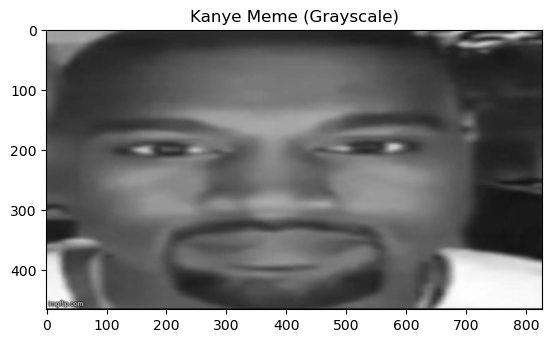

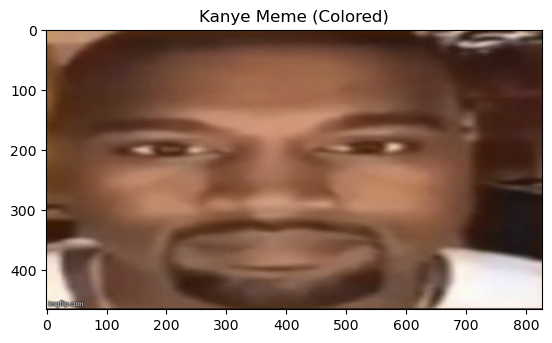

In [33]:
kanye_meme_gryscl = cv2.imread("./images/kanye.jpg", 0)
kanye_meme_colored = cv2.imread("./images/kanye.jpg", 1)
print(kanye_meme_gryscl)



print(
    f"\nImage Details \nShape: {kanye_meme_gryscl.shape}\nDtype: {kanye_meme_gryscl.dtype}"
)
print(
    f"\nImage Details \nShape: {kanye_meme_colored.shape}\nDtype: {kanye_meme_colored.dtype}"
)


plt.title("Kanye Meme (Grayscale)")



plt.imshow(kanye_meme_gryscl, cmap="gray")
plt.show()

plt.title("Kanye Meme (Colored)")
kanye_meme_colored_reversed_channels = kanye_meme_colored[:, :, ::-1]
plt.imshow(kanye_meme_colored_reversed_channels)
plt.show()

[[  0   0   0   0   0   0 255 255 255 255 255 255   0   0   0   0   0   0]
 [  0   0   0   0   0   0 255 255 255 255 255 255   0   0   0   0   0   0]
 [  0   0   0   0   0   0 255 255 255 255 255 255   0   0   0   0   0   0]
 [  0   0   0   0   0   0 255 255 255 255 255 255   0   0   0   0   0   0]
 [  0   0   0   0   0   0 255 255 255 255 255 255   0   0   0   0   0   0]
 [  0   0   0   0   0   0 255 255 255 255 255 255   0   0   0   0   0   0]
 [255 255 255 255 255 255   0   0   0   0   0   0 255 255 255 255 255 255]
 [255 255 255 255 255 255   0   0   0   0   0   0 255 255 255 255 255 255]
 [255 255 255 255 255 255   0   0   0   0   0   0 255 255 255 255 255 255]
 [255 255 255 255 255 255   0   0   0   0   0   0 255 255 255 255 255 255]
 [255 255 255 255 255 255   0   0   0   0   0   0 255 255 255 255 255 255]
 [255 255 255 255 255 255   0   0   0   0   0   0 255 255 255 255 255 255]
 [  0   0   0   0   0   0 255 255 255 255 255 255   0   0   0   0   0   0]
 [  0   0   0   0   0   0

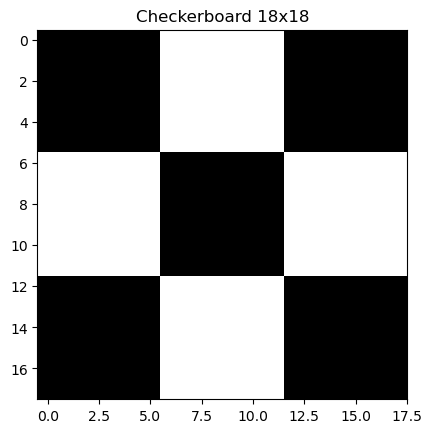

In [34]:
# Read image as gray scale.
cb_img = cv2.imread("./images/checkerboard_18x18.png", 0)

# Print the image data (pixel values), element of a 2D numpy array.
# Each pixel value is 8-bits [0,255]
print(cb_img)

plt.title("Checkerboard 18x18")
plt.imshow(cb_img, cmap="gray")
plt.show()

[[158 159 160 ... 238 238 237]
 [158 159 160 ... 238 238 237]
 [158 159 160 ... 237 237 237]
 ...
 [253 253 253 ... 254 255 255]
 [253 253 253 ... 254 255 255]
 [253 253 253 ... 254 255 255]]


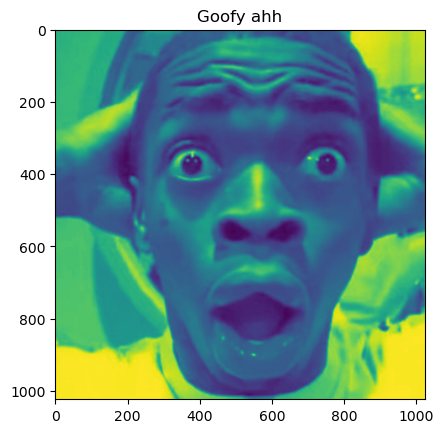

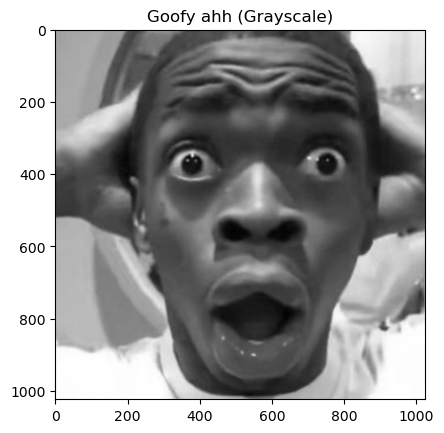

In [43]:
goofy_grayscale = cv2.imread("./images/goofy-ahh.jpg", 0)
print(goofy_grayscale)

plt.title("Goofy ahh")
plt.imshow(goofy_grayscale)
plt.show()



plt.title("Goofy ahh (Grayscale)")
plt.imshow(goofy_grayscale, cmap="gray")
plt.show()

## Display Image attributes

In [44]:
# print the size  of image
print("Image size (H, W) is:", cb_img.shape)

# print data-type of image
print("Data type of image is:", cb_img.dtype)

Image size (H, W) is: (18, 18)
Data type of image is: uint8


## Display Images using Matplotlib

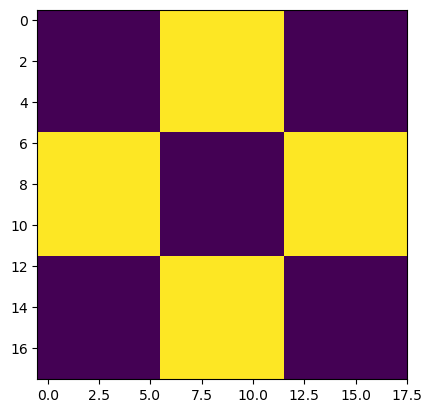

In [52]:
# Display image.
plt.imshow(cb_img)
plt.show()

### What happened?

Even though the image was read in as a gray scale image, it won't necessarily display in gray scale when using `imshow()`. matplotlib uses different color maps and it's possible that the gray scale color map is not set.

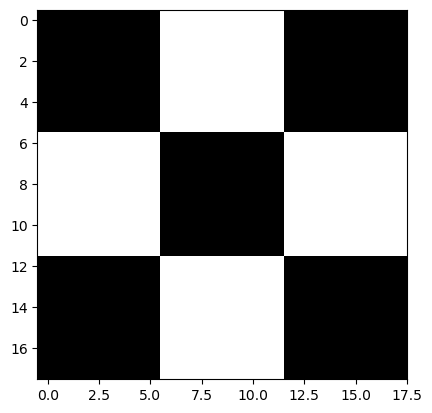

In [53]:
# Set color map to gray scale for proper rendering.
plt.imshow(cb_img, cmap="gray")
plt.show()

## Another example

[[  0   0  15  20   1 134 233 253 253 253 255 229 130   1  29   2   0   0]
 [  0   1   5  18   0 137 232 255 254 247 255 228 129   0  24   2   0   0]
 [  7   5   2  28   2 139 230 254 255 249 255 226 128   0  27   3   2   2]
 [ 25  27  28  38   0 129 236 255 253 249 251 227 129   0  36  27  27  27]
 [  2   0   0   4   2 130 239 254 254 254 255 230 126   0   4   2   0   0]
 [132 129 131 124 121 163 211 226 227 225 226 203 164 125 125 129 131 131]
 [234 227 230 229 232 205 151 115 125 124 117 156 205 232 229 225 228 228]
 [254 255 255 251 255 222 102   1   0   0   0 120 225 255 254 255 255 255]
 [254 255 254 255 253 225 104   0  50  46   0 120 233 254 247 253 251 253]
 [252 250 250 253 254 223 105   2  45  50   0 127 223 255 251 255 251 253]
 [254 255 255 252 255 226 104   0   1   1   0 120 229 255 255 254 255 255]
 [233 235 231 233 234 207 142 106 108 102 108 146 207 235 237 232 231 231]
 [132 132 131 132 130 175 207 223 224 224 224 210 165 134 130 136 134 134]
 [  1   1   3   0   0 129

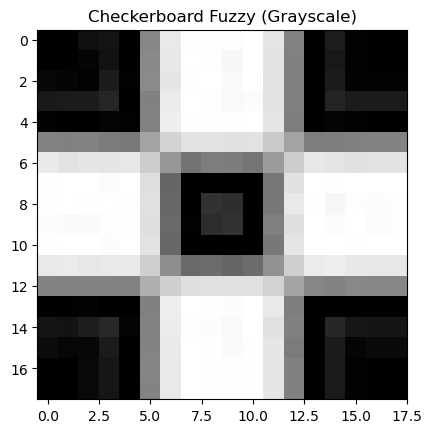

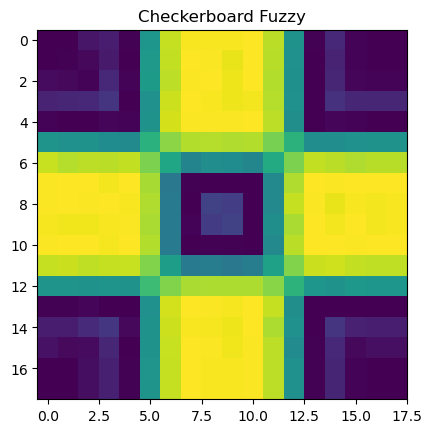

In [56]:
# Read image as gray scale.
cb_img_fuzzy = cv2.imread("./images/checkerboard_fuzzy_18x18.jpg", 0)

# print image
print(cb_img_fuzzy)

# Display image.
plt.imshow(cb_img_fuzzy, cmap="gray")
plt.title("Checkerboard Fuzzy (Grayscale)")
plt.show()

plt.imshow(cb_img_fuzzy)
plt.title("Checkerboard Fuzzy")
plt.show()

## Working with Color Images
Until now, we have been using gray scale images in our discussion. Let us now discuss color images.

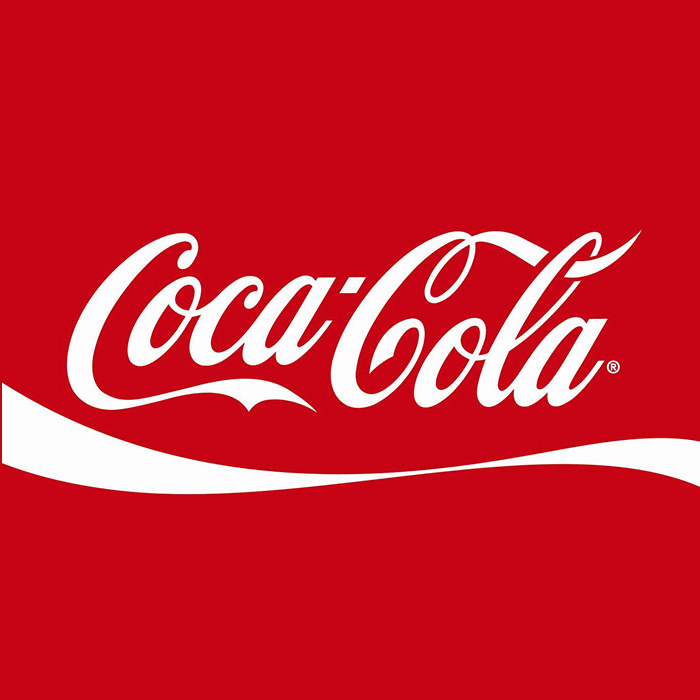

In [57]:
# Read and display Coca-Cola logo.
Image("./images/coca-cola-logo.png")

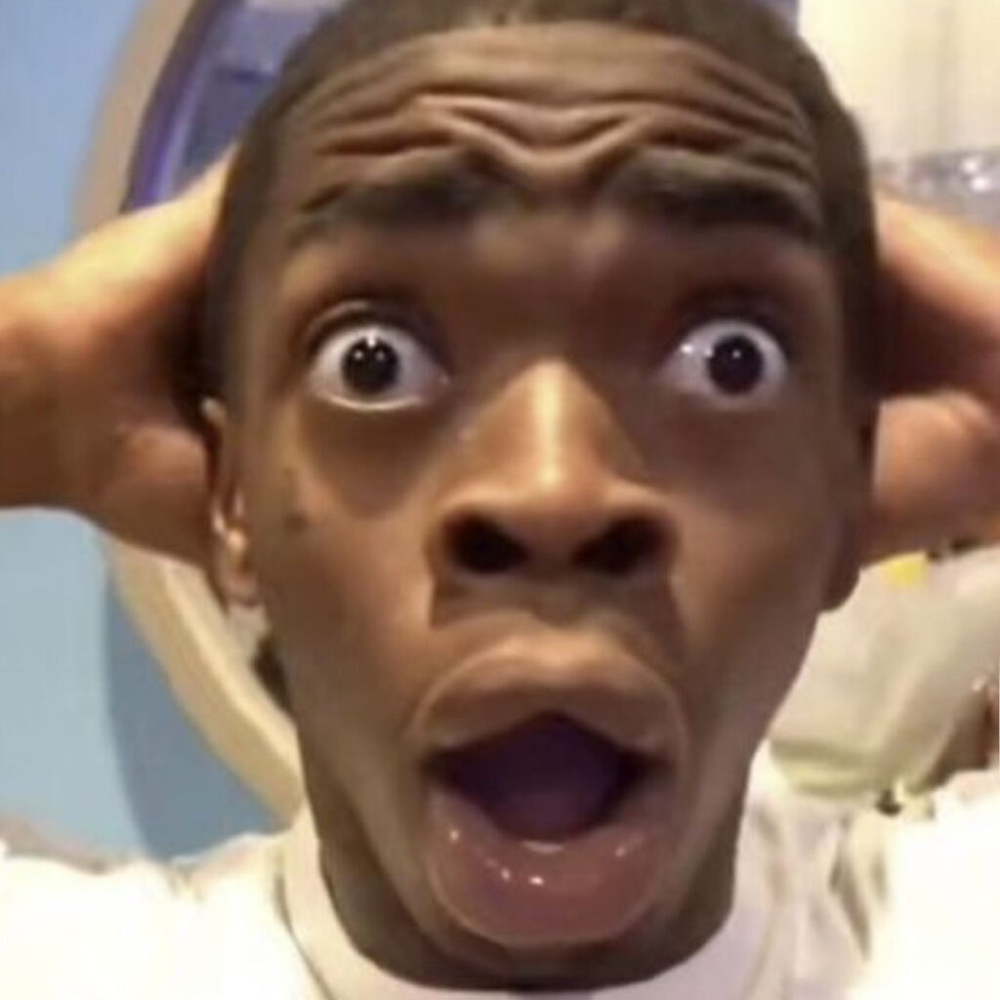

In [58]:
Image("./images/goofy-ahh.jpg", height=200, width=200)

## Read and display color image
Let us read a color image and check the parameters. Note the image dimension.

In [59]:
# Read in image
coke_img = cv2.imread("./images/coca-cola-logo.png", 1)

# print the size  of image
print("Image size (H, W, C) is:", coke_img.shape)

# print data-type of image
print("Data type of image is:", coke_img.dtype)

Image size (H, W, C) is: (700, 700, 3)
Data type of image is: uint8


## Display the Image

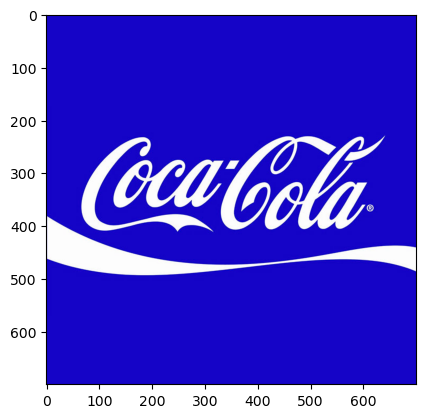

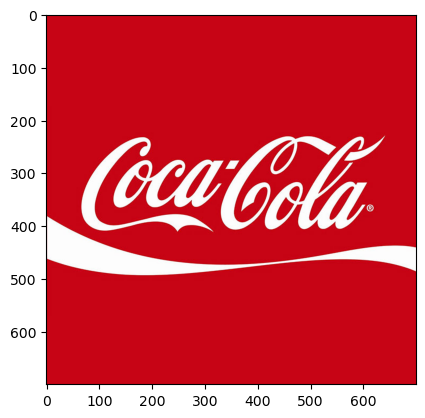

In [62]:
plt.imshow(coke_img)
plt.show()

reversed_coke_image = coke_img[:, :, ::-1]
plt.imshow(reversed_coke_image)
plt.show()

#  What happened?

(900, 900, 3)


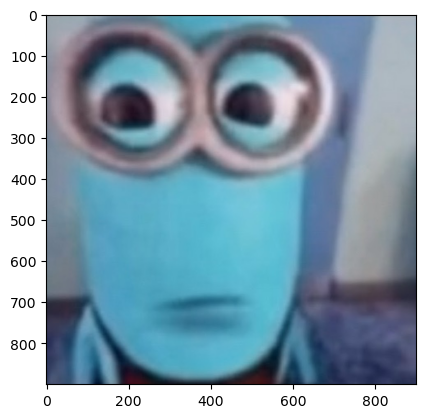

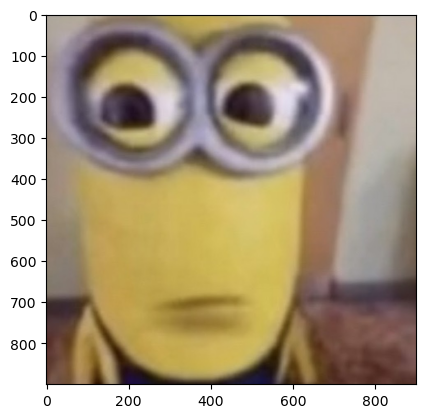

In [65]:
minion = cv2.imread("./images/minion.jpg", 1)
print(minion.shape)

plt.imshow(minion)
plt.show()

reversed_minion = minion[:, :, ::-1]
plt.imshow(reversed_minion)
plt.show()

The color displayed above is different from the actual image. This is because matplotlib expects the image in RGB format whereas OpenCV stores images in BGR format. Thus, for correct display, we need to reverse the channels of the image. We will discuss about the channels in the sections below.

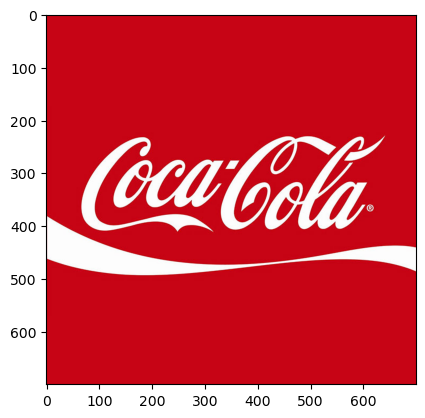

In [69]:
coke_img_channels_reversed = coke_img[:, :, ::-1]
plt.imshow(coke_img_channels_reversed)
plt.show()

Image Details
Shape: (1414, 2121, 3)
Dtype: uint8


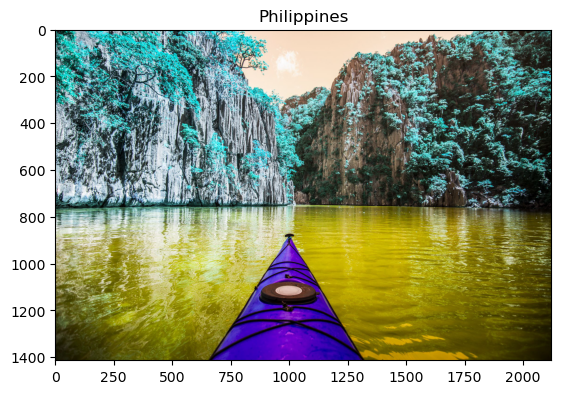

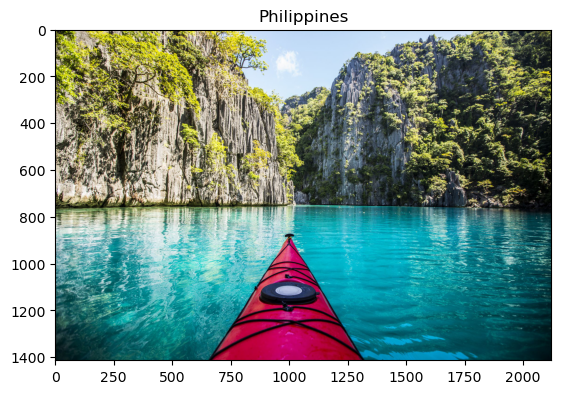

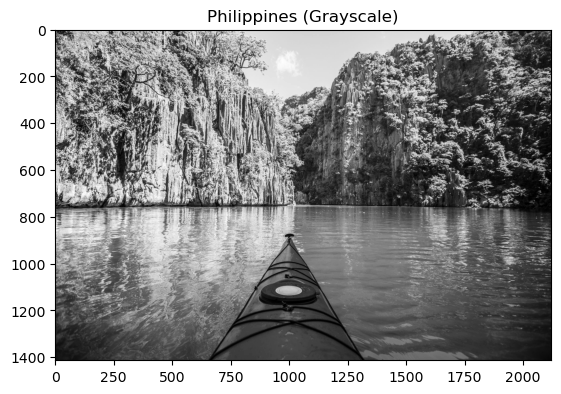

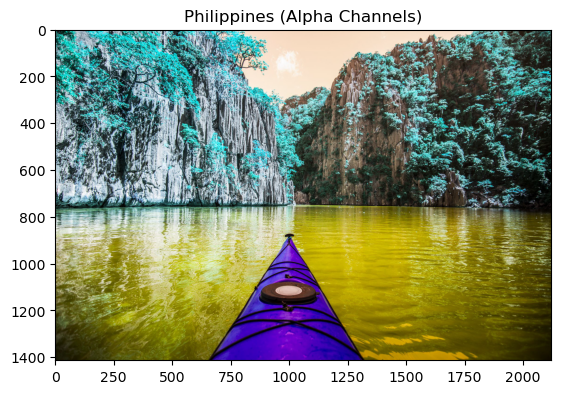

In [71]:
philippines = cv2.imread("./images/philippines.jpg", 1)
philippines_grayscale = cv2.imread("./images/philippines.jpg", 0)
philippines_alpha = cv2.imread("./images/philippines.jpg", -1)
print(f"Image Details\nShape: {philippines.shape}\nDtype: {philippines.dtype}")

plt.title("Philippines")
plt.imshow(philippines)
plt.show()

plt.title("Philippines")
reversed_image_chnls_ph = philippines[:, :, ::-1]
plt.imshow(reversed_image_chnls_ph)
plt.show()

plt.title("Philippines (Grayscale)")
plt.imshow(philippines_grayscale, cmap="gray")
plt.show()

plt.title("Philippines (Alpha Channels)")
plt.imshow(philippines_alpha)
plt.show()

## Splitting and Merging Color Channels


* **`cv2.split()`** Divides a multi-channel array into several single-channel arrays.

* **`cv2.merge()`** Merges several arrays to make a single multi-channel array. All the input matrices must have the same size.

### <font style="color:rgb(8,133,37)">OpenCV Documentation</font>

<a href="https://docs.opencv.org/4.5.1/d2/de8/group__core__array.html#ga0547c7fed86152d7e9d0096029c8518a" target="_blank">Documentation link</a>

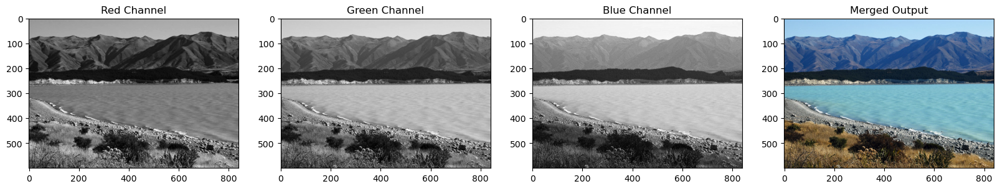

In [74]:
# Split the image into the B,G,R components
img_NZ_bgr = cv2.imread("./images/New_Zealand_Lake.jpg", cv2.IMREAD_COLOR)
b, g, r = cv2.split(img_NZ_bgr)

# Show the channels
plt.figure(figsize=[20, 5])
plt.subplot(141)
plt.imshow(r, cmap="gray")
plt.title("Red Channel")

plt.subplot(142)
plt.imshow(g, cmap="gray")
plt.title("Green Channel")

plt.subplot(143)
plt.imshow(b, cmap="gray")
plt.title("Blue Channel")

# Merge the individual channels into a BGR image
imgMerged = cv2.merge((b, g, r))
# Show the merged output
plt.subplot(144)
plt.title("Merged Output")
plt.imshow(imgMerged[:, :, ::-1])
plt.show()

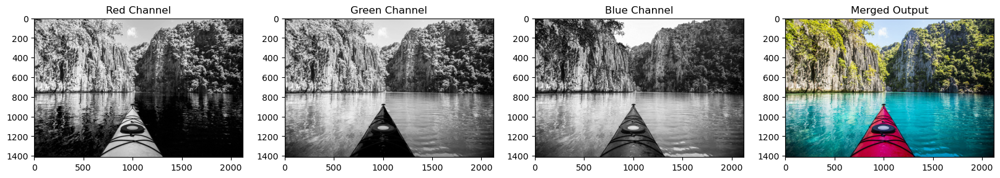

In [91]:
philippines_img = cv2.imread("./images/philippines.jpg", 1)

# Split the BGR image into its channels
b, g, r = cv2.split(philippines_img)

# Show the channels
plt.figure(figsize=[20, 5])
plt.subplot(1, 4, 1)
plt.imshow(r, cmap="gray")
plt.title("Red Channel")

plt.subplot(1, 4, 2)
plt.imshow(g, cmap="gray")
plt.title("Green Channel")

plt.subplot(1, 4, 3)
plt.imshow(b, cmap="gray")
plt.title("Blue Channel")

# Merge the individual channels into a BGR image
imgMerged = cv2.merge((b, g, r))
# Show the merged output
plt.subplot(1, 4, 4)
plt.title("Merged Output")
plt.imshow(imgMerged[:, :, ::-1])
plt.show()

## Converting to different Color Spaces


**`cv2.cvtColor()`** Converts an image from one color space to another. The function converts an input image from one color space to another. In case of a transformation to-from RGB color space, the order of the channels should be specified explicitly (RGB or BGR). Note that the default color format in OpenCV is often referred to as RGB but it is actually BGR (the bytes are reversed). So the first byte in a standard (24-bit) color image will be an 8-bit Blue component, the second byte will be Green, and the third byte will be Red. The fourth, fifth, and sixth bytes would then be the second pixel (Blue, then Green, then Red), and so on.

### <font style="color:rgb(8,133,37)">Function Syntax </font>
``` python
dst = cv2.cvtColor( src, code )
```

`dst`: Is the output image of the same size and depth as `src`.

The function has **2 required arguments**:

1. `src` input image: 8-bit unsigned, 16-bit unsigned ( CV_16UC... ), or single-precision floating-point.

2. `code` color space conversion code (see ColorConversionCodes).

### <font style="color:rgb(8,133,37)">OpenCV Documentation</font>

1. **`cv2.cvtColor`**: <a href="https://docs.opencv.org/3.4/d8/d01/group__imgproc__color__conversions.html#ga397ae87e1288a81d2363b61574eb8cab" target="_blank">Documentation link</a>  

2. **`ColorConversionCodes`**: <a href="https://docs.opencv.org/4.5.1/d8/d01/group__imgproc__color__conversions.html#ga4e0972be5de079fed4e3a10e24ef5ef0" target="_blank">Documentation link</a>


### Changing from BGR to RGB

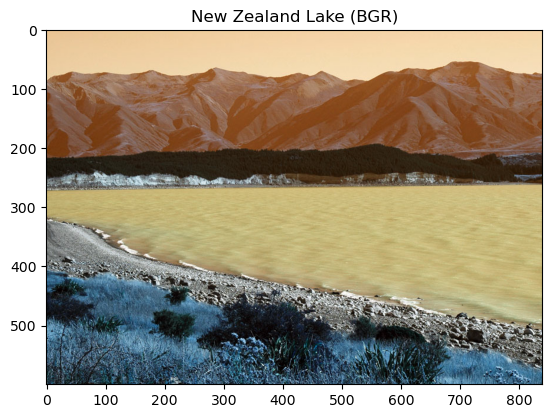

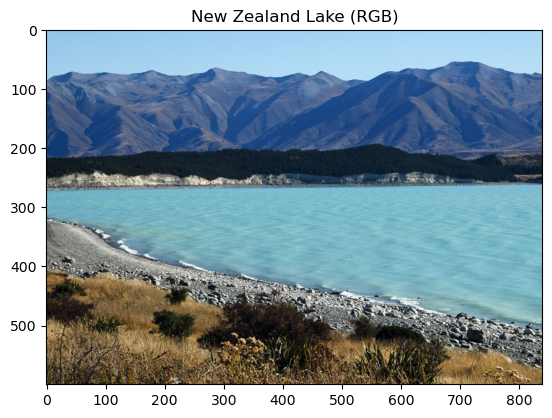

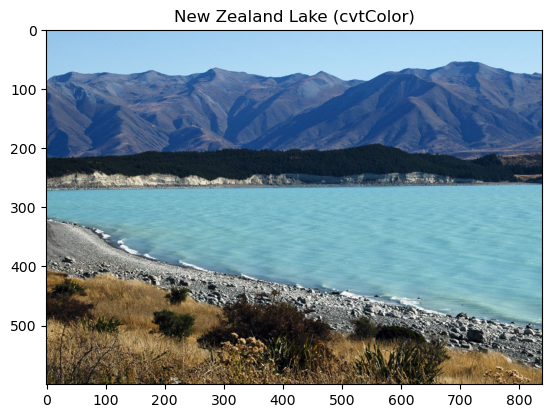

In [132]:
img_NZ_bgr = cv2.imread("./images/New_Zealand_Lake.jpg", cv2.IMREAD_COLOR)

plt.imshow(img_NZ_bgr)
plt.title("New Zealand Lake (BGR)")
plt.show()

img_NZ_rev_chnnl = img_NZ_bgr[:, :, ::-1]
plt.title("New Zealand Lake (RGB)")
plt.imshow(img_NZ_rev_chnnl)
plt.show()

img_NZ_rgb = cv2.cvtColor(img_NZ_bgr, cv2.COLOR_BGR2RGB)
plt.imshow(img_NZ_rgb)
plt.title("New Zealand Lake (cvtColor)")
plt.show()

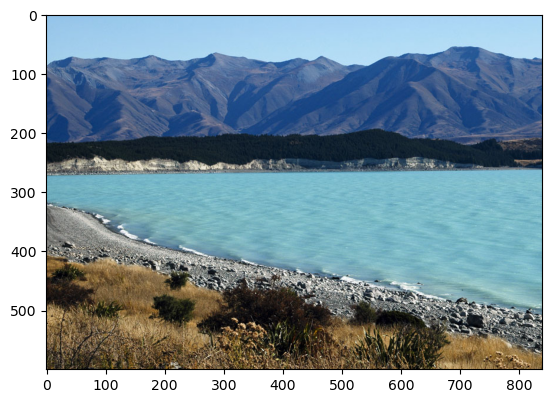

In [139]:
# OpenCV stores color channels in a differnet order than most other applications (BGR vs RGB).
img_NZ_rgb = cv2.cvtColor(img_NZ_bgr, cv2.COLOR_BGR2RGB)
plt.imshow(img_NZ_rgb)
plt.show()

### Changing to HSV color space

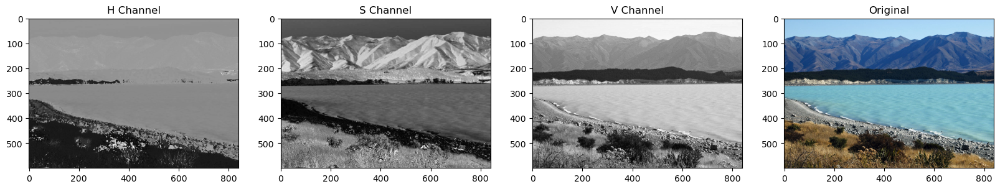

In [143]:
img_hsv = cv2.cvtColor(img_NZ_bgr, cv2.COLOR_BGR2HSV)

# Split the image into the H,S,V components
h, s, v = cv2.split(img_hsv)

# Show the channels
plt.figure(figsize=[20, 5])
plt.subplot(1, 4, 1)
plt.imshow(h, cmap="gray")
plt.title("H Channel")

plt.subplot(1, 4, 2)
plt.imshow(s, cmap="gray")
plt.title("S Channel")

plt.subplot(1, 4, 3)
plt.imshow(v, cmap="gray")
plt.title("V Channel")

plt.subplot(1, 4, 4)
plt.imshow(img_NZ_rgb)
plt.title("Original")
plt.show()

## Modifying individual Channel

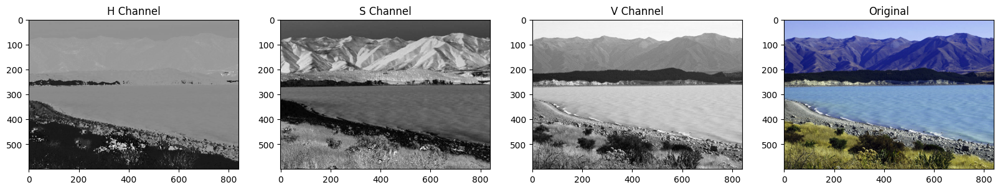

In [ ]:
h_new = h + 10
img_NZ_merged = cv2.merge((h_new, s, v))
img_NZ_rgb = cv2.cvtColor(img_NZ_merged, cv2.COLOR_HSV2RGB)

# Show the channels
plt.figure(figsize=[20, 5])
plt.subplot(141)
plt.imshow(h, cmap="gray")
plt.title("H Channel")
plt.subplot(142)
plt.imshow(s, cmap="gray")
plt.title("S Channel")
plt.subplot(143)
plt.imshow(v, cmap="gray")
plt.title("V Channel")
plt.subplot(144)
plt.imshow(img_NZ_rgb)
plt.title("Original")

## Saving Images

Saving the image is as trivial as reading an image in OpenCV. We use the function **`cv2.imwrite()`** with two arguments. The first one is the filename, second argument is the image object.

The function imwrite saves the image to the specified file. The image format is chosen based on the filename extension (see cv::imread for the list of extensions). In general, only 8-bit single-channel or 3-channel (with 'BGR' channel order) images can be saved using this function (see the OpenCV documentation for further details).


### <font style="color:rgb(8,133,37)">Function Syntax </font>
``` python
cv2.imwrite( filename, img[, params] )
```

The function has **2 required arguments**:

1. `filename`: This can be an **absolute** or **relative** path.

2. `img`: Image or Images to be saved.

### <font style="color:rgb(8,133,37)">OpenCV Documentation</font>

1. **`Imwrite`**: <a href="https://docs.opencv.org/4.5.1/d4/da8/group__imgcodecs.html#gabbc7ef1aa2edfaa87772f1202d67e0ce" target="_blank">Documentation link</a>

2. **`ImwriteFlags`**: <a href="https://docs.opencv.org/4.5.1/d8/d6a/group__imgcodecs__flags.html#ga292d81be8d76901bff7988d18d2b42ac" target="_blank">Documentation link</a>

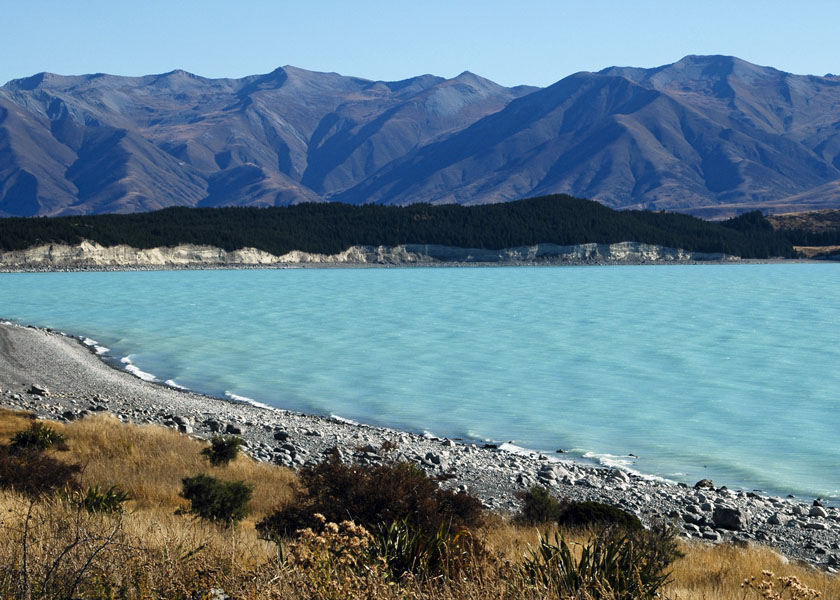

In [ ]:
# save the image
cv2.imwrite("New_Zealand_Lake_SAVED.png", img_NZ_bgr)

Image(filename="New_Zealand_Lake_SAVED.png")

In [ ]:
# read the image as Color
img_NZ_bgr = cv2.imread("New_Zealand_Lake_SAVED.png", cv2.IMREAD_COLOR)
print("img_NZ_bgr shape (H, W, C) is:", img_NZ_bgr.shape)

# read the image as Grayscaled
img_NZ_gry = cv2.imread("New_Zealand_Lake_SAVED.png", cv2.IMREAD_GRAYSCALE)
print("img_NZ_gry shape (H, W) is:", img_NZ_gry.shape)

img_NZ_bgr shape (H, W, C) is: (600, 840, 3)
img_NZ_gry shape (H, W) is: (600, 840)


## Thank You!

### Exercise

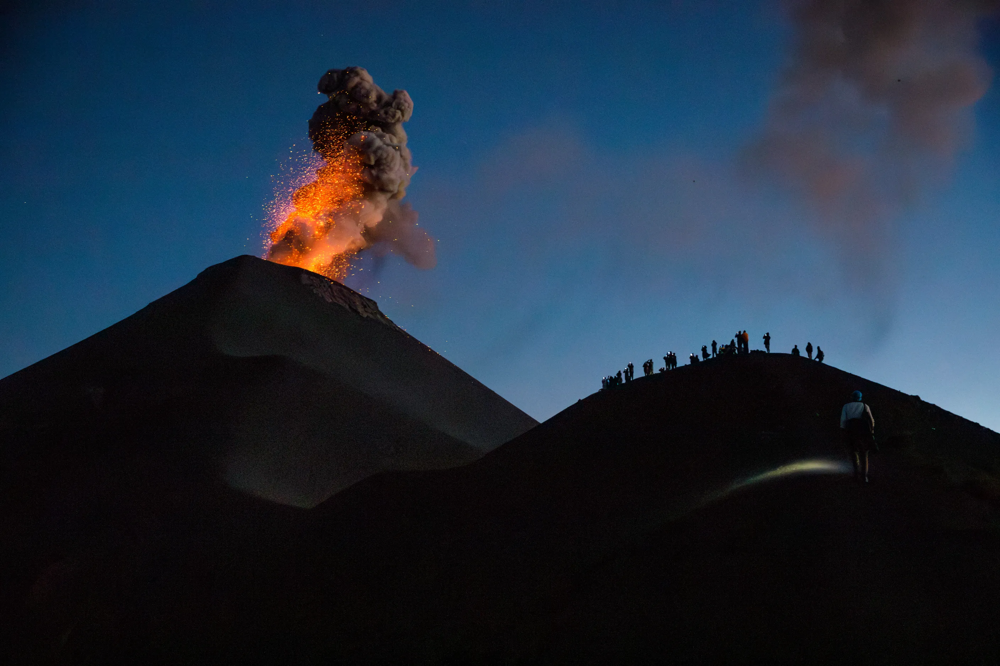

In [100]:
Image("./images/nat-geo.png")

### Grayscale

Shape: (1878, 2816)
Dtype: uint8


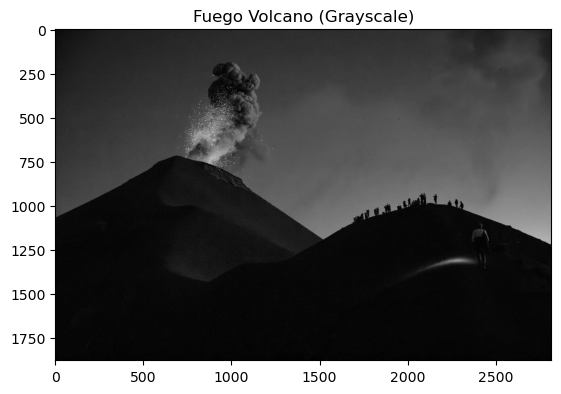

In [113]:
nat_geo_img = cv2.imread("./images/nat-geo.png", 0)
print(f"Shape: {nat_geo_img.shape}\nDtype: {nat_geo_img.dtype}")

plt.imshow(nat_geo_img, cmap="gray")
plt.title("Fuego Volcano (Grayscale)")
plt.show()

### Colored

Shape: (1878, 2816, 3)
Dtype: uint8


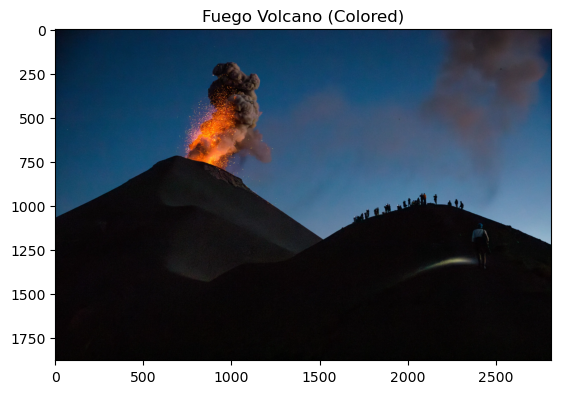

In [114]:
nat_geo_img = cv2.imread("./images/nat-geo.png", 1)
print(f"Shape: {nat_geo_img.shape}\nDtype: {nat_geo_img.dtype}")

nat_geo_img_reversed_channels = nat_geo_img[:, :, ::-1]

plt.imshow(nat_geo_img_reversed_channels)
plt.title("Fuego Volcano (Colored)")
plt.show()

### Alpha

Shape: (1878, 2816, 3)
Dtype: uint8


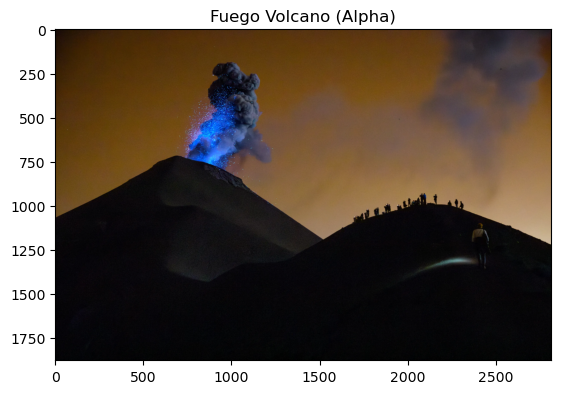

In [115]:
nat_geo_img = cv2.imread("./images/nat-geo.png", -1)
print(f"Shape: {nat_geo_img.shape}\nDtype: {nat_geo_img.dtype}")

plt.imshow(nat_geo_img)
plt.title("Fuego Volcano (Alpha)")
plt.show()

### Split and Merge

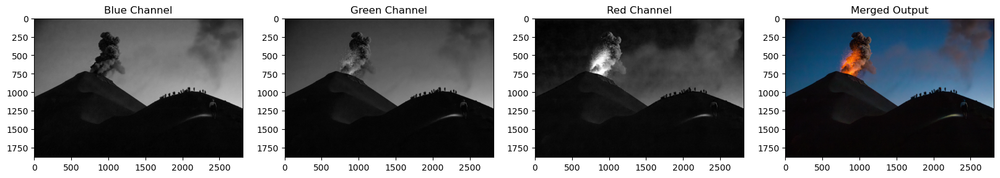

In [152]:
nat_geo_img = cv2.imread("./images/nat-geo.png", 1)

b, g, r = cv2.split(nat_geo_img)

plt.figure(figsize=(20, 15))
plt.subplot(1, 4, 1)
plt.imshow(b, cmap="gray")
plt.title("Blue Channel")

plt.subplot(1, 4, 2)
plt.imshow(g, cmap="gray")
plt.title("Green Channel")

plt.subplot(1, 4, 3)
plt.imshow(r, cmap="gray")
plt.title("Red Channel")

nat_geo_img_merged = cv2.merge((b, g, r))
plt.subplot(1, 4, 4)
plt.imshow(nat_geo_img_merged[:, :, ::-1])
plt.title("Merged Output")

plt.show()

### cvtColor

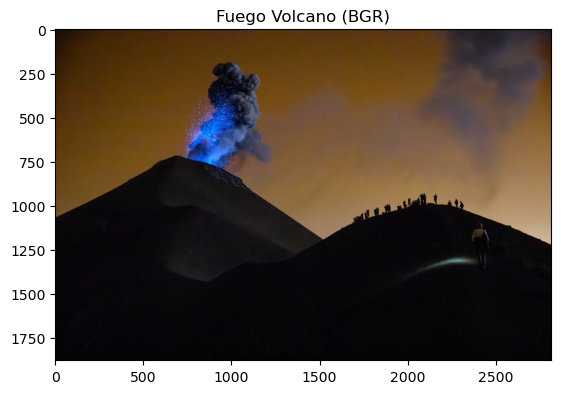

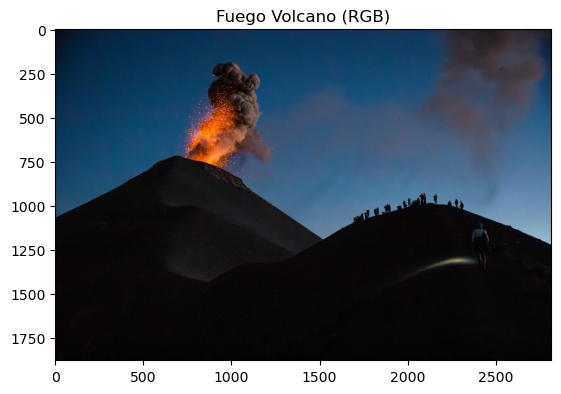

In [170]:
nat_geo_img_bgr = cv2.imread("./images/nat-geo.png", 1)

plt.imshow(nat_geo_img_bgr)
plt.title("Fuego Volcano (BGR)")
plt.show()

nat_geo_img_rgb = cv2.cvtColor(nat_geo_img_bgr, cv2.COLOR_BGR2RGB)
plt.imshow(nat_geo_img_rgb)
plt.title("Fuego Volcano (RGB)")
plt.show()

### Hue, Saturation, Value

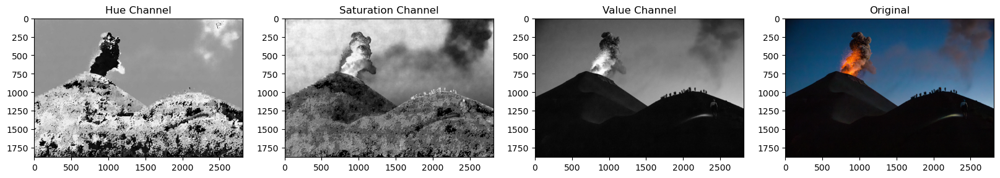

In [159]:
nat_geo_hsv = cv2.cvtColor(nat_geo_img_bgr, cv2.COLOR_BGR2HSV)
h, s, v = cv2.split(nat_geo_hsv)

plt.figure(figsize=(20, 15))
plt.subplot(1, 4, 1)
plt.imshow(h, cmap="gray")
plt.title("Hue Channel")

plt.subplot(1, 4, 2)
plt.imshow(s, cmap="gray")
plt.title("Saturation Channel")

plt.subplot(1, 4, 3)
plt.imshow(v, cmap="gray")
plt.title("Value Channel")

plt.subplot(1, 4, 4)
plt.imshow(nat_geo_img_rgb)
plt.title("Original")

plt.show()

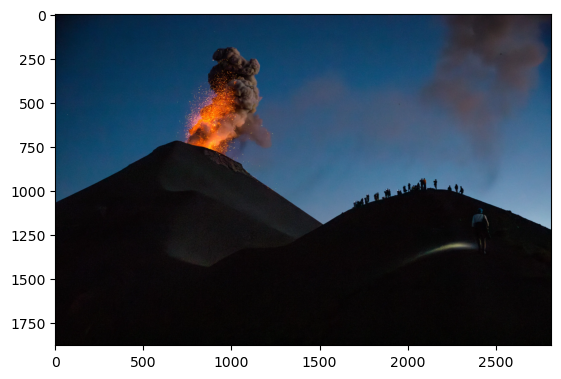

In [169]:
plt.imshow(nat_geo_img_rgb)
plt.show()

### Saving Images

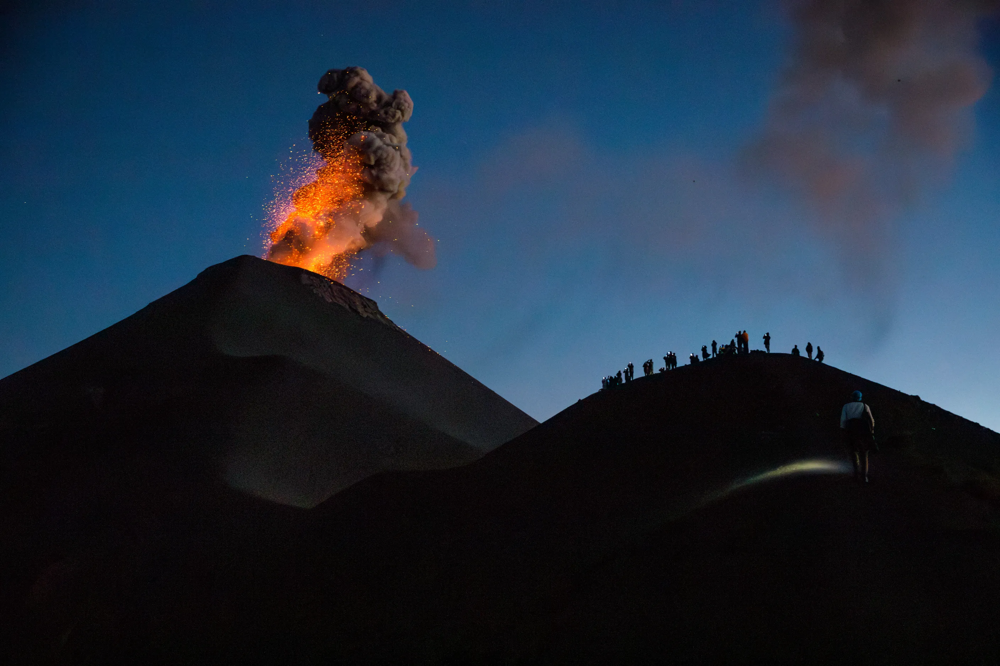

In [175]:
cv2.imwrite("./images/Fuego_Volcano_Eruption.png", nat_geo_img_bgr)

Image("./images/Fuego_Volcano_Eruption.png")